In [8]:
import pandas as pd, numpy as np
import matplotlib.pyplot as plt
import os
import re

In [23]:
dict_params = {}
dataframes = {}

eval_params ={}
eval_dfs = {}
i = 0
for foldername, foldchildren, filechildren in os.walk('./results/v02/'):
    if 'julia' in foldername:
        continue
    
    if len(filechildren) > 0:
        for file in filechildren:
            # regex = "./[a-z]*/[a-z|0-9]*\\[A-Z|_]*\\[a-z|_|\-|0-9|\.|=]*$"
            # print(foldername)
            
             #re.search(regex, foldername):
            split = foldername.replace('n_steps','n-steps').replace('\\','/').split('/')
            filename = os.path.join(foldername, file) 

            

            if 'evaluation' not in foldername:

                model = split[3]
                params = split[4].split('_')
                

                r ={'model':model}
                for p in params:
                    x = p.split('=')
                    r[x[0]] = float(x[1])

                if dict_params.get(foldername) is None:
                    dict_params[foldername] = r
                    dataframes[foldername] = {}

                dataframes[foldername][file.replace("checkpoint_","").replace('.csv', "")] = filename #.append(pd.read_csv(, parse_dates=[0], index_col=0))
            else:
                print(filename)  

                model = split[3]
                params = split[5].split('_')
                

                r ={'model':model}
                for p in params:
                    x = p.split('=')
                    r[x[0]] = float(x[1])
                    
                if eval_params.get(foldername) is None:
                    eval_params[foldername] = r
                    eval_dfs[foldername] = {}

                eval_dfs[foldername][file.replace("checkpoint_","").replace('.csv', "")] = filename #.append(pd.read_csv(, parse_dates=[0], index_col=0))

            #     print(model, params, filename)
            # else:
            #     split = foldername.replace('n_steps','n-steps').replace('\\','/').split('/')
            #     filename = os.path.join(foldername, file) 

            #     print(split)  
            #     model = split[3]
            #     params = split[4].split('_')
                

            #     r ={'model':model}
            #     for p in params:
            #         x = p.split('=')
            #         r[x[0]] = float(x[1])

            #     if dict_params.get(foldername) is None:
            #         dict_params[foldername] = r
            #         dataframes[foldername] = {}

            #     dataframes[foldername][file.replace("checkpoint_","").replace('.csv', "")] = filename #.append(pd.read_csv(, parse_dates=[0], index_col=0))

            #     print(model, params, filename)


./results/v02/REINFORCE/evaluation/learning-rate=0.7_decay-rate=0.9_tuple-size=160/checkpoint_7.csv
./results/v02/REINFORCE/evaluation/learning-rate=0.7_decay-rate=0.9_tuple-size=160/checkpoint_6.csv
./results/v02/REINFORCE/evaluation/learning-rate=0.7_decay-rate=0.9_tuple-size=160/checkpoint_4.csv
./results/v02/REINFORCE/evaluation/learning-rate=0.7_decay-rate=0.9_tuple-size=160/checkpoint_5.csv
./results/v02/REINFORCE/evaluation/learning-rate=0.7_decay-rate=0.9_tuple-size=160/checkpoint_1.csv
./results/v02/REINFORCE/evaluation/learning-rate=0.7_decay-rate=0.9_tuple-size=160/checkpoint_2.csv
./results/v02/REINFORCE/evaluation/learning-rate=0.7_decay-rate=0.9_tuple-size=160/checkpoint_3.csv
./results/v02/REINFORCE/evaluation/learning-rate=0.7_decay-rate=0.9_tuple-size=160/checkpoint_24.csv
./results/v02/REINFORCE/evaluation/learning-rate=0.7_decay-rate=0.9_tuple-size=160/checkpoint_18.csv
./results/v02/REINFORCE/evaluation/learning-rate=0.7_decay-rate=0.9_tuple-size=160/checkpoint_19.c

In [10]:
data = {}

In [24]:
import random

In [25]:
folders = list(dict_params.keys())
random.shuffle(folders)

In [26]:
wqnn_foldername = './results/v02/WQNN/evaluation/epsilon=0.98_learning-rate=0.9_decay-rate=0.25_forget-factor=0.25_tuple-size=160'
sarsa_foldername = './results/v02/SARSA/evaluation/epsilon=0.9_learning-rate=0.25_decay-rate=0.25_n_steps=4_tuple-size=160'
reinforce_foldername = './results/v02/REINFORCE/evaluation/learning-rate=0.98_decay-rate=0.7_tuple-size=160'
actor_foldername = './results/v02/ACTOR_CRITIC/evaluation/learning-rate=0.5_decay-rate=0.7_n-steps=8_tuple-size=20'

In [27]:
for foldername in folders:
    params = dict_params[foldername]
    key = str(params)
    if "deepq" in foldername.lower():
    
        continue
    if data.get(key) is None:
        data[key] = { "POA":{}, "reward":{}, "transp":{}}


    print(foldername)

    for checkpoint in dataframes[foldername]:
        df = pd.read_csv(dataframes[foldername][checkpoint], parse_dates=[0], index_col=0)
        s = df.sum()

        if data[key]['POA'].get(checkpoint) is None:    
            data[key]['POA'][checkpoint] = []
        data[key]['POA'][checkpoint].append(s.POA)

        if data[key]['reward'].get(checkpoint) is None:    
            data[key]['reward'][checkpoint] = []
        data[key]['reward'][checkpoint].append(s.reward)

        if data[key]['transp'].get(checkpoint) is None:    
            data[key]['transp'][checkpoint] = []
        data[key]['transp'][checkpoint].append(s.POA/s.ghi)


KeyError: './results/v02/WQNN/evaluation/epsilon=0.98_learning-rate=0.9_decay-rate=0.25_forget-factor=0.25_tuple-size=160'

In [4]:
df

,mghi,ghi,mdhi,dhi,mdni,dni,mg,mangle,zenith,azimuth,angle,POA,reward
ts,,,,,,,,,,,,,
2022-08-26 00:15:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-141.294115,-101.484062,0.0,0.0,0.0
2022-08-26 00:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-144.675929,-103.930178,0.0,0.0,0.0
2022-08-26 00:45:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-148.019227,-106.742878,0.0,0.0,0.0
2022-08-26 01:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-151.308921,-110.048613,0.0,0.0,0.0
2022-08-26 01:15:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-154.522665,-114.029779,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-26 23:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-124.038209,-92.752014,0.0,0.0,0.0
2022-08-26 23:15:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-127.498369,-94.339294,0.0,0.0,0.0
2022-08-26 23:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-130.950967,-96.028061,0.0,0.0,0.0


In [33]:
eval_data = {}

for foldername in [wqnn_foldername, sarsa_foldername,reinforce_foldername,actor_foldername]:
    params = eval_params[foldername]
    key = str(params)
    if eval_data.get(key) is None:
        eval_data[key] = { "POA":{}, "reward":{}, "ghi":{}, "mg":{}}

    print(foldername)

    for checkpoint in eval_dfs[foldername]:
        print(checkpoint)
        df = pd.read_csv(eval_dfs[foldername][checkpoint], parse_dates=[0], index_col=0)
        s = df.sum()

        if eval_data[key]['POA'].get(checkpoint) is None:    
            eval_data[key]['POA'][checkpoint] = []
        eval_data[key]['POA'][checkpoint].append(s.POA)

        if eval_data[key]['reward'].get(checkpoint) is None:    
            eval_data[key]['reward'][checkpoint] = []
        eval_data[key]['reward'][checkpoint].append(s.reward)

        if eval_data[key]['ghi'].get(checkpoint) is None:    
            eval_data[key]['ghi'][checkpoint] = []
        eval_data[key]['ghi'][checkpoint].append(s.ghi)

        if eval_data[key]['mg'].get(checkpoint) is None:    
            eval_data[key]['mg'][checkpoint] = []
        eval_data[key]['mg'][checkpoint].append(s.mg)






./results/v02/WQNN/evaluation/epsilon=0.98_learning-rate=0.9_decay-rate=0.25_forget-factor=0.25_tuple-size=160
7
6
4
5
1
2
3
24
18
19


OSError: [Errno 89] Operation canceled

In [17]:
x = []
for key in eval_data:

    
    print(key)
    for checkpoint in eval_data[key]['ghi']:
        print(checkpoint)
        params = eval(key)

        params['checkpoint'] =checkpoint
        params['ghi'] = eval_data[key]['ghi'][checkpoint][0]
        params['POA'] = eval_data[key]['POA'][checkpoint][0]
        params['mg'] = eval_data[key]['mg'][checkpoint][0]
        x.append(params)

    # if (params['model'] == model)&(params.get(criterion) == value):
        # for checkpoint in data[key]['transp']:
        #     if x.get(checkpoint) is None:
        #         x[checkpoint] = []
        #     x[checkpoint] += data[key]['transp'][checkpoint]
# raw = [{'checkpoint':int(i) , 'mean': np.mean(x[i]) , 'std': np.std(x[i]) } for i in x]
total = pd.DataFrame(x).fillna(0)
grouped = total.groupby(['model', 'learning-rate', 'decay-rate', 'n-steps', 'tuple-size', 'epsilon', 'forget-factor'])[['ghi',"mg", 'POA']].sum().assign(transp = lambda x: x.POA/x.ghi, transp_astro = lambda x: x.mg/x.ghi, ratio = lambda x: x.POA/x.mg).sort_values('transp', ascending=False).query('ghi > 456457').reset_index()
grouped.head(10)


KeyError: 'model'

In [9]:
import plotly.express as px
fig = px.box(grouped[grouped['model'].isin(['SARSA', "WQNN"])], x="epsilon", y="transp", color="model")
fig.update_layout(
xaxis_title="Greedy rate", yaxis_title="Hor.", 
)
fig.update_xaxes(
    tickvals = [0.25, 0.5, 0.7, 0.9, 0.98]
)
# fig.write_image('state-values-eps-curve-2.jpg')
fig.show()

In [19]:
import plotly.express as px
fig = px.box(grouped[grouped['model'].isin(['SARSA', "WQNN"])], x="decay-rate", y="transp", color="model")
fig.update_layout(
xaxis_title="Decay rate", yaxis_title="Hor.", 
)
fig.update_xaxes(
    tickvals = [0.25, 0.5, 0.7, 0.9, 0.98]
)
# fig.write_image('state-values-dr-curve-2.jpg')
fig.show()

In [21]:
import plotly.express as px
fig = px.box(grouped[grouped['model'].isin(['SARSA', "WQNN"])], x="learning-rate", y="transp", color="model")
fig.update_layout(
xaxis_title="Learning rate", yaxis_title="Hor.", 
)
fig.update_xaxes(
    tickvals = [0.25, 0.5, 0.7, 0.9, 0.98]
)
# fig.write_image('state-values-dr-curve-2.jpg')
fig.show()

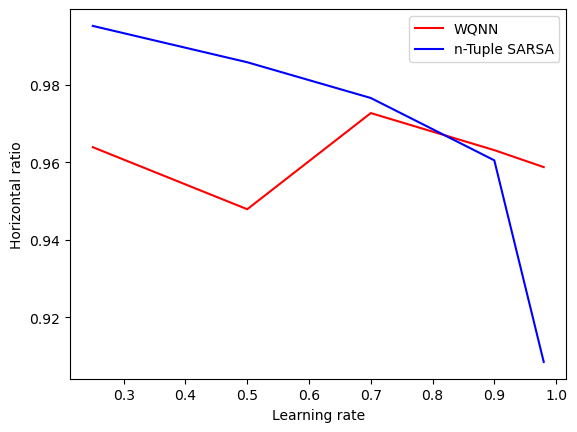

In [11]:
plt.plot(grouped[grouped['model'].isin(['WQNN'])].groupby('learning-rate')[['transp']].mean(), color='red', label='WQNN')
plt.plot(grouped[grouped['model'].isin(['SARSA'])].groupby('learning-rate')[['transp']].mean(), color='blue', label='n-Tuple SARSA')
plt.xlabel("Learning rate")
plt.ylabel("Horizontal ratio")
plt.legend()

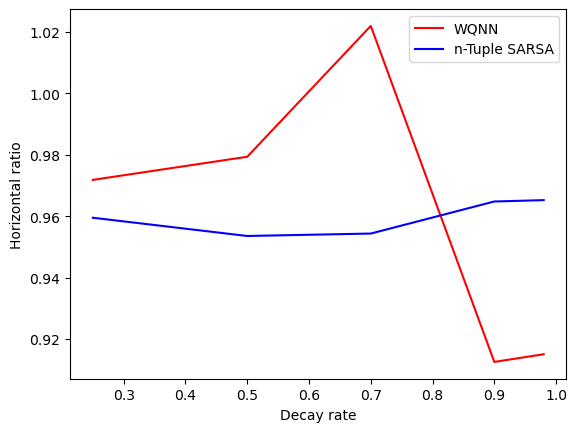

In [12]:
plt.plot(grouped[grouped['model'].isin(['WQNN'])].groupby('decay-rate')[['transp']].mean(), color='red', label='WQNN')
plt.plot(grouped[grouped['model'].isin(['SARSA'])].groupby('decay-rate')[['transp']].mean(), color='blue', label='n-Tuple SARSA')
plt.xlabel("Decay rate")
plt.ylabel("Horizontal ratio")
plt.legend()

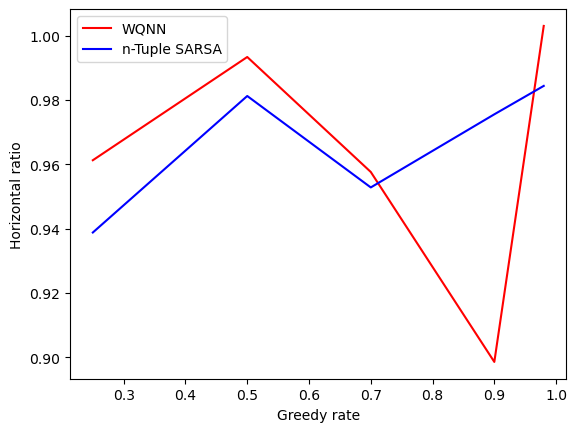

In [13]:
plt.plot(grouped[grouped['model'].isin(['WQNN'])].groupby('epsilon')[['transp']].mean(), color='red', label='WQNN')
plt.plot(grouped[grouped['model'].isin(['SARSA'])].groupby('epsilon')[['transp']].mean(), color='blue', label='n-Tuple SARSA')

plt.xlabel("Greedy rate")
plt.ylabel("Horizontal ratio")
plt.legend()

In [14]:
pd.DataFrame(x).assign(tranps = lambda x: x.POA/x.ghi).groupby('model').mean()

,learning-rate,decay-rate,n-steps,tuple-size,checkpoint,ghi,POA,mg,epsilon,forget-factor,tranps
model,,,,,,,,,,,
ACTOR_CRITIC,0.686594,0.568841,3.398551,92.971014,7979073416051895576451322072773521699330349397...,18837.394555,18212.474658,20682.025942,NaN,NaN,0.964100
REINFORCE,0.592381,0.672857,NaN,149.523810,inf,18258.284276,17497.574843,20228.260586,NaN,NaN,0.952641
SARSA,0.735245,0.446877,6.217747,185.344425,inf,18260.078636,17524.504114,20229.666567,0.513792,NaN,0.953316
WQNN,0.793375,0.459250,NaN,186.000000,inf,18258.284276,17576.015887,20228.260586,0.449500,0.617125,0.956453


In [15]:
total[total['model'].isin(['WQNN',"SARSA"])].assign(transp = lambda x: x.POA/x.ghi).groupby('checkpoint')[['transp']].mean().sort_values('transp')

,transp
checkpoint,
11,0.899078
17,0.905994
19,0.911899
15,0.912294
23,0.917110
25,0.919978
1,0.922196
4,0.926671
24,0.938984


In [16]:
best_days = [7, 21]
worst_days = [11, 17]

In [17]:
foldername

'./results/v02\\WQNN\\evaluation\\epsilon=0.9_learning-rate=0.9_decay-rate=0.9_forget-factor=0.25_tuple-size=320'

In [18]:
   learning-rate  decay-rate  tuple-size    transp
0           0.98         0.7       160.0  1.004582


SyntaxError: invalid syntax (3075546372.py, line 1)

In [15]:
6, 12, 1

(6, 12, 1)

In [16]:
day = '3'
df = pd.read_csv(eval_dfs[wqnn_foldername][day], parse_dates=[0], index_col=0)
df2 = pd.read_csv(eval_dfs[sarsa_foldername][day], parse_dates=[0], index_col=0)
plot_df = df[['POA','mg','ghi']].join(df2[['POA']], rsuffix='_Sarsa').query('ghi >0')
plt.plot(plot_df.index, plot_df.ghi,'-.', color='grey',  label= 'Horizontal')
plt.plot(plot_df.index, plot_df.mg,'--', color='black',  label= 'Astro')
plt.plot(plot_df.index, plot_df.POA,'-', color='red',  label= 'wQNN')
plt.plot(plot_df.index, plot_df.POA_Sarsa,'-', color='blue',  label= 'N-tuple SARSA')

plt.legend()
plt.xticks([plot_df.index[int(len(plot_df)/2)]])
plt.ylim([0, 1200])

KeyError: './results/v02\\WQNN\\evaluation\\epsilon=0.98_learning-rate=0.9_decay-rate=0.25_forget-factor=0.25_tuple-size=160'

(0.0, 1200.0)

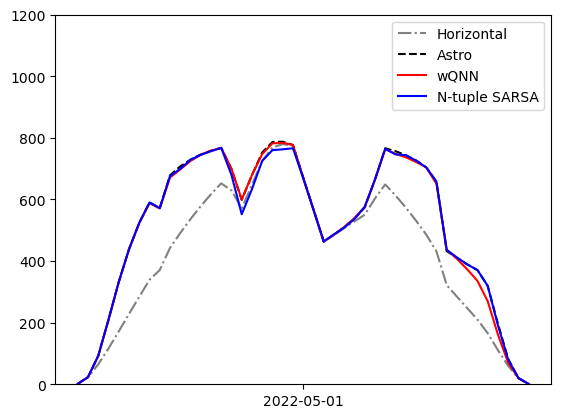

In [ ]:
day = '9'
df = pd.read_csv(eval_dfs[wqnn_foldername][day], parse_dates=[0], index_col=0)
df2 = pd.read_csv(eval_dfs[sarsa_foldername][day], parse_dates=[0], index_col=0)
plot_df = df[['POA','mg','ghi']].join(df2[['POA']], rsuffix='_Sarsa').query('ghi >0')
plt.plot(plot_df.index, plot_df.ghi,'-.', color='grey',  label= 'Horizontal')
plt.plot(plot_df.index, plot_df.mg,'--', color='black',  label= 'Astro')
plt.plot(plot_df.index, plot_df.POA,'-', color='red',  label= 'wQNN')
plt.plot(plot_df.index, plot_df.POA_Sarsa,'-', color='blue',  label= 'N-tuple SARSA')

plt.legend()
plt.xticks([plot_df.index[int(len(plot_df)/2)]])
plt.ylim([0, 1200])

(0.0, 1200.0)

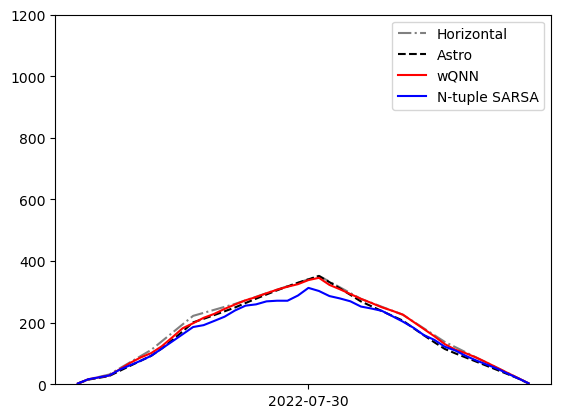

In [ ]:
day = '15'
df = pd.read_csv(eval_dfs[wqnn_foldername][day], parse_dates=[0], index_col=0)
df2 = pd.read_csv(eval_dfs[sarsa_foldername][day], parse_dates=[0], index_col=0)
plot_df = df[['POA','mg','ghi']].join(df2[['POA']], rsuffix='_Sarsa').query('ghi >0')
plt.plot(plot_df.index, plot_df.ghi,'-.', color='grey',  label= 'Horizontal')
plt.plot(plot_df.index, plot_df.mg,'--', color='black',  label= 'Astro')
plt.plot(plot_df.index, plot_df.POA,'-', color='red',  label= 'wQNN')
plt.plot(plot_df.index, plot_df.POA_Sarsa,'-', color='blue',  label= 'N-tuple SARSA')

plt.legend()
plt.xticks([plot_df.index[int(len(plot_df)/2)]])
plt.ylim([0, 1200])

(0.0, 1200.0)

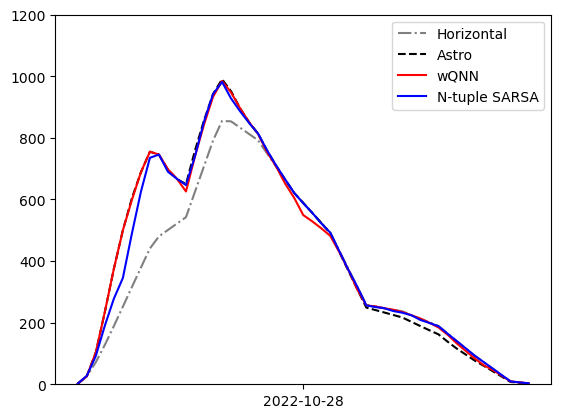

In [ ]:
day = '21'
df = pd.read_csv(eval_dfs[wqnn_foldername][day], parse_dates=[0], index_col=0)
df2 = pd.read_csv(eval_dfs[sarsa_foldername][day], parse_dates=[0], index_col=0)
plot_df = df[['POA','mg','ghi']].join(df2[['POA']], rsuffix='_Sarsa').query('ghi >0')
plt.plot(plot_df.index, plot_df.ghi,'-.', color='grey',  label= 'Horizontal')
plt.plot(plot_df.index, plot_df.mg,'--', color='black',  label= 'Astro')
plt.plot(plot_df.index, plot_df.POA,'-', color='red',  label= 'wQNN')
plt.plot(plot_df.index, plot_df.POA_Sarsa,'-', color='blue',  label= 'N-tuple SARSA')

plt.legend()
plt.xticks([plot_df.index[int(len(plot_df)/2)]])
plt.ylim([0, 1200])

(0.0, 1200.0)

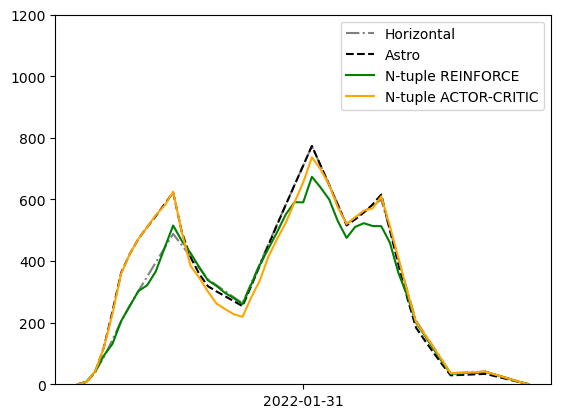

In [ ]:
day = '3'
df = pd.read_csv(eval_dfs[reinforce_foldername][day], parse_dates=[0], index_col=0)
df2 = pd.read_csv(eval_dfs[actor_foldername][day], parse_dates=[0], index_col=0)
plot_df = df[['POA','mg','ghi']].join(df2[['POA']], rsuffix='_Sarsa').query('ghi >0')
plt.plot(plot_df.index, plot_df.ghi,'-.', color='grey',  label= 'Horizontal')
plt.plot(plot_df.index, plot_df.mg,'--', color='black',  label= 'Astro')
plt.plot(plot_df.index, plot_df.POA,'-', color='green',  label= 'N-tuple REINFORCE')
plt.plot(plot_df.index, plot_df.POA_Sarsa,'-', color='orange',  label= 'N-tuple ACTOR-CRITIC')

plt.legend()
plt.xticks([plot_df.index[int(len(plot_df)/2)]])
plt.ylim([0, 1200])

(0.0, 1200.0)

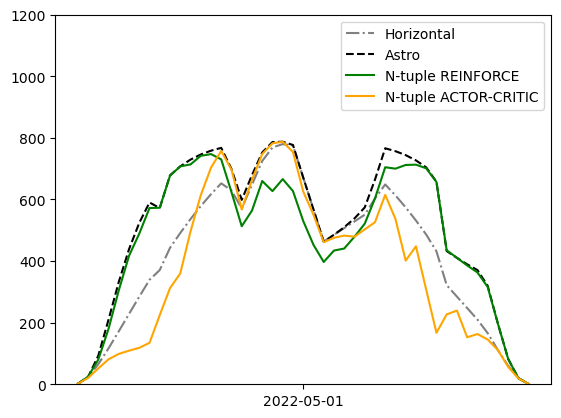

In [ ]:
day = '9'
df = pd.read_csv(eval_dfs[reinforce_foldername][day], parse_dates=[0], index_col=0)
df2 = pd.read_csv(eval_dfs[actor_foldername][day], parse_dates=[0], index_col=0)
plot_df = df[['POA','mg','ghi']].join(df2[['POA']], rsuffix='_Sarsa').query('ghi >0')
plt.plot(plot_df.index, plot_df.ghi,'-.', color='grey',  label= 'Horizontal')
plt.plot(plot_df.index, plot_df.mg,'--', color='black',  label= 'Astro')
plt.plot(plot_df.index, plot_df.POA,'-', color='green',  label= 'N-tuple REINFORCE')
plt.plot(plot_df.index, plot_df.POA_Sarsa,'-', color='orange',  label= 'N-tuple ACTOR-CRITIC')


plt.legend()
plt.xticks([plot_df.index[int(len(plot_df)/2)]])
plt.ylim([0, 1200])

(0.0, 1200.0)

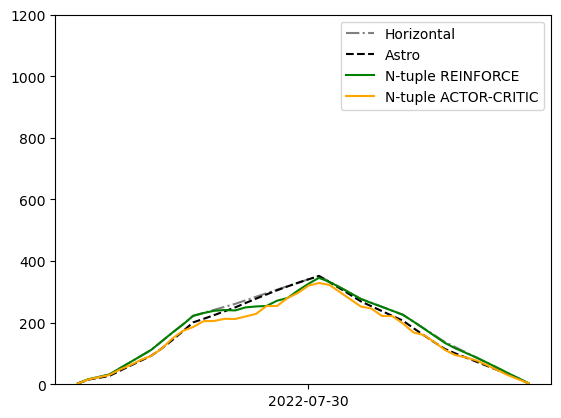

In [ ]:
day = '15'
df = pd.read_csv(eval_dfs[reinforce_foldername][day], parse_dates=[0], index_col=0)
df2 = pd.read_csv(eval_dfs[actor_foldername][day], parse_dates=[0], index_col=0)
plot_df = df[['POA','mg','ghi']].join(df2[['POA']], rsuffix='_Sarsa').query('ghi >0')
plt.plot(plot_df.index, plot_df.ghi,'-.', color='grey',  label= 'Horizontal')
plt.plot(plot_df.index, plot_df.mg,'--', color='black',  label= 'Astro')
plt.plot(plot_df.index, plot_df.POA,'-', color='green',  label= 'N-tuple REINFORCE')
plt.plot(plot_df.index, plot_df.POA_Sarsa,'-', color='orange',  label= 'N-tuple ACTOR-CRITIC')


plt.legend()
plt.xticks([plot_df.index[int(len(plot_df)/2)]])
plt.ylim([0, 1200])

(0.0, 1200.0)

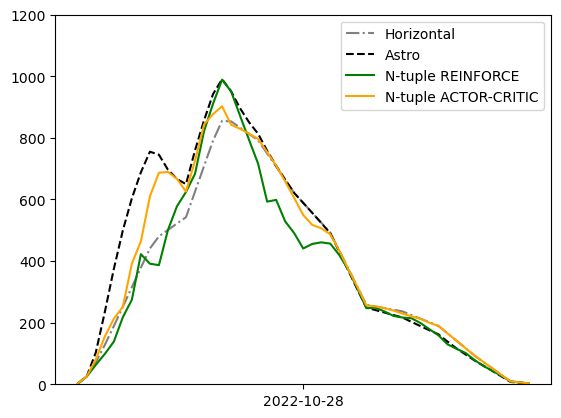

In [ ]:
day = '21'
df = pd.read_csv(eval_dfs[reinforce_foldername][day], parse_dates=[0], index_col=0)
df2 = pd.read_csv(eval_dfs[actor_foldername][day], parse_dates=[0], index_col=0)
plot_df = df[['POA','mg','ghi']].join(df2[['POA']], rsuffix='_Sarsa').query('ghi >0')
plt.plot(plot_df.index, plot_df.ghi,'-.', color='grey',  label= 'Horizontal')
plt.plot(plot_df.index, plot_df.mg,'--', color='black',  label= 'Astro')
plt.plot(plot_df.index, plot_df.POA,'-', color='green',  label= 'N-tuple REINFORCE')
plt.plot(plot_df.index, plot_df.POA_Sarsa,'-', color='orange',  label= 'N-tuple ACTOR-CRITIC')


plt.legend()
plt.xticks([plot_df.index[int(len(plot_df)/2)]])
plt.ylim([0, 1200])

In [ ]:
total[total['model'].isin(['WQNN',"SARSA"])].assign(transp = lambda x: x.POA/x.mg).groupby('checkpoint')[['transp']].mean().sort_values('transp')

,transp
checkpoint,
14,0.779215
9,0.791964
16,0.806982
12,0.809478
8,0.844744
6,0.846138
20,0.846220
7,0.847051
2,0.853280


In [ ]:
total[total['model'].isin(['WQNN',"SARSA"])].assign(transp = lambda x: x.POA/x.mg).groupby('checkpoint')[['transp']].mean().sort_values('transp')

,transp
checkpoint,
14,0.779215
9,0.791964
16,0.806982
12,0.809478
8,0.844744
6,0.846138
20,0.846220
7,0.847051
2,0.853280


,model,learning-rate,decay-rate,n-steps,tuple-size,epsilon,forget-factor,ghi,mg,POA,transp,transp_astro,ratio
0,WQNN,0.90,0.25,0.0,160.0,0.98,0.25,456457.10689,505706.514638,501870.922977,1.099492,1.107895,0.992415
1,SARSA,0.25,0.25,4.0,160.0,0.90,0.00,456457.10689,505706.514638,498388.658189,1.091863,1.107895,0.985529
2,SARSA,0.70,0.50,4.0,40.0,0.90,0.00,456457.10689,505706.514638,496427.084056,1.087566,1.107895,0.981651
3,WQNN,0.70,0.25,0.0,40.0,0.98,0.98,456457.10689,505706.514638,495771.943984,1.086130,1.107895,0.980355
4,SARSA,0.25,0.25,4.0,80.0,0.98,0.00,456457.10689,505706.514638,495651.872642,1.085867,1.107895,0.980118
5,WQNN,0.25,0.25,0.0,40.0,0.70,0.25,456457.10689,505706.514638,495051.674589,1.084552,1.107895,0.978931
6,SARSA,0.70,0.90,4.0,80.0,0.98,0.00,456457.10689,505706.514638,493683.625085,1.081555,1.107895,0.976226
7,SARSA,0.25,0.50,2.0,80.0,0.90,0.00,456457.10689,505706.514638,493460.993783,1.081068,1.107895,0.975785
8,WQNN,0.90,0.70,0.0,160.0,0.98,0.25,456457.10689,505706.514638,493191.882769,1.080478,1.107895,0.975253
9,SARSA,0.25,0.25,1.0,80.0,0.90,0.00,456457.10689,505706.514638,493175.505831,1.080442,1.107895,0.975221


In [ ]:
grouped[grouped['model']=="WQNN"].head(5)

,model,learning-rate,decay-rate,n-steps,tuple-size,epsilon,forget-factor,ghi,mg,POA,transp,transp_astro,ratio
0,WQNN,0.90,0.25,0.0,160.0,0.98,0.25,456457.10689,505706.514638,501870.922977,1.099492,1.107895,0.992415
3,WQNN,0.70,0.25,0.0,40.0,0.98,0.98,456457.10689,505706.514638,495771.943984,1.086130,1.107895,0.980355
5,WQNN,0.25,0.25,0.0,40.0,0.70,0.25,456457.10689,505706.514638,495051.674589,1.084552,1.107895,0.978931
8,WQNN,0.90,0.70,0.0,160.0,0.98,0.25,456457.10689,505706.514638,493191.882769,1.080478,1.107895,0.975253
11,WQNN,0.98,0.25,0.0,160.0,0.90,0.98,456457.10689,505706.514638,492193.443500,1.078291,1.107895,0.973279


In [ ]:
grouped[grouped['model']=="REINFORCE"].head(5)

,model,learning-rate,decay-rate,n-steps,tuple-size,epsilon,forget-factor,ghi,mg,POA,transp,transp_astro
109,REINFORCE,0.98,0.7,0.0,160.0,0.0,0.0,456457.10689,505706.514638,458548.394075,1.004582,1.107895
128,REINFORCE,0.98,0.5,0.0,160.0,0.0,0.0,456457.10689,505706.514638,453364.850674,0.993226,1.107895
140,REINFORCE,0.70,0.5,0.0,320.0,0.0,0.0,456457.10689,505706.514638,451910.606376,0.990040,1.107895
165,REINFORCE,0.70,0.7,0.0,160.0,0.0,0.0,456457.10689,505706.514638,448806.786954,0.983240,1.107895
169,REINFORCE,0.50,0.7,0.0,160.0,0.0,0.0,456457.10689,505706.514638,448437.289230,0.982430,1.107895


In [ ]:
grouped.model.unique()

array(['WQNN', 'SARSA', 'ACTOR_CRITIC', 'REINFORCE'], dtype=object)

In [ ]:
grouped[grouped['model']=="ACTOR_CRITIC"].head(5)

,model,learning-rate,decay-rate,n-steps,tuple-size,epsilon,forget-factor,ghi,mg,POA,transp,transp_astro
87,ACTOR_CRITIC,0.50,0.70,8.0,20.0,0.0,0.0,456457.10689,505706.514638,464635.031000,1.017916,1.107895
124,ACTOR_CRITIC,0.98,0.70,2.0,160.0,0.0,0.0,456457.10689,505706.514638,454903.114909,0.996596,1.107895
125,ACTOR_CRITIC,0.98,0.25,1.0,10.0,0.0,0.0,456457.10689,505706.514638,454867.034202,0.996516,1.107895
274,ACTOR_CRITIC,0.70,0.98,1.0,80.0,0.0,0.0,456457.10689,505706.514638,436349.959217,0.955950,1.107895
348,ACTOR_CRITIC,0.25,0.25,4.0,160.0,0.0,0.0,456457.10689,505706.514638,425043.630148,0.931180,1.107895


In [ ]:
def rank(df):
    print(df)
    df.index += 1
    return df

In [ ]:
print(grouped[grouped['model']=="SARSA"].reset_index().query('ghi > 456457').head(5).drop(columns=['index','model','ghi','mg','POA', 'transp_astro','forget-factor']).pipe(lambda x: rank(x)).to_latex(float_format='{:0.02f}'.format))

   learning-rate  decay-rate  n-steps  tuple-size  epsilon    transp     ratio
0           0.25        0.25      4.0       160.0     0.90  1.091863  0.985529
1           0.70        0.50      4.0        40.0     0.90  1.087566  0.981651
2           0.25        0.25      4.0        80.0     0.98  1.085867  0.980118
3           0.70        0.90      4.0        80.0     0.98  1.081555  0.976226
4           0.25        0.50      2.0        80.0     0.90  1.081068  0.975785
\begin{tabular}{lrrrrrrr}
\toprule
 & learning-rate & decay-rate & n-steps & tuple-size & epsilon & transp & ratio \\
\midrule
1 & 0.25 & 0.25 & 4.00 & 160.00 & 0.90 & 1.09 & 0.99 \\
2 & 0.70 & 0.50 & 4.00 & 40.00 & 0.90 & 1.09 & 0.98 \\
3 & 0.25 & 0.25 & 4.00 & 80.00 & 0.98 & 1.09 & 0.98 \\
4 & 0.70 & 0.90 & 4.00 & 80.00 & 0.98 & 1.08 & 0.98 \\
5 & 0.25 & 0.50 & 2.00 & 80.00 & 0.90 & 1.08 & 0.98 \\
\bottomrule
\end{tabular}



In [ ]:
print(grouped[grouped['model']=="WQNN"].reset_index().query('ghi > 456457').head(5).drop(columns=['index','model','ghi','mg','POA', 'transp_astro']).pipe(lambda x: rank(x)).to_latex(float_format='{:0.02f}'.format))

   learning-rate  decay-rate  n-steps  tuple-size  epsilon  forget-factor  \
0           0.90        0.25      0.0       160.0     0.98           0.25   
1           0.70        0.25      0.0        40.0     0.98           0.98   
2           0.25        0.25      0.0        40.0     0.70           0.25   
3           0.90        0.70      0.0       160.0     0.98           0.25   
4           0.98        0.25      0.0       160.0     0.90           0.98   

     transp     ratio  
0  1.099492  0.992415  
1  1.086130  0.980355  
2  1.084552  0.978931  
3  1.080478  0.975253  
4  1.078291  0.973279  
\begin{tabular}{lrrrrrrrr}
\toprule
 & learning-rate & decay-rate & n-steps & tuple-size & epsilon & forget-factor & transp & ratio \\
\midrule
1 & 0.90 & 0.25 & 0.00 & 160.00 & 0.98 & 0.25 & 1.10 & 0.99 \\
2 & 0.70 & 0.25 & 0.00 & 40.00 & 0.98 & 0.98 & 1.09 & 0.98 \\
3 & 0.25 & 0.25 & 0.00 & 40.00 & 0.70 & 0.25 & 1.08 & 0.98 \\
4 & 0.90 & 0.70 & 0.00 & 160.00 & 0.98 & 0.25 & 1.08 & 0.98 \\

In [ ]:
print(grouped[grouped['model']=="REINFORCE"].reset_index().query('ghi > 456457').head(5).drop(columns=['index','model','n-steps','epsilon','forget-factor','ghi','mg','POA', 'transp_astro']).pipe(lambda x: rank(x)).to_latex(float_format='{:0.02f}'.format))

   learning-rate  decay-rate  tuple-size    transp
0           0.98         0.7       160.0  1.004582
1           0.98         0.5       160.0  0.993226
2           0.70         0.5       320.0  0.990040
3           0.70         0.7       160.0  0.983240
4           0.50         0.7       160.0  0.982430
\begin{tabular}{lrrrr}
\toprule
 & learning-rate & decay-rate & tuple-size & transp \\
\midrule
1 & 0.98 & 0.70 & 160.00 & 1.00 \\
2 & 0.98 & 0.50 & 160.00 & 0.99 \\
3 & 0.70 & 0.50 & 320.00 & 0.99 \\
4 & 0.70 & 0.70 & 160.00 & 0.98 \\
5 & 0.50 & 0.70 & 160.00 & 0.98 \\
\bottomrule
\end{tabular}



In [ ]:
print(grouped.reset_index().query('ghi > 456457').head(10).drop(columns=['index','ghi','mg','POA', 'transp_astro']).pipe(lambda x: rank(x)).to_latex(float_format='{:0.02f}'.format))

   model  learning-rate  decay-rate  n-steps  tuple-size  epsilon  \
0   WQNN           0.90        0.25      0.0       160.0     0.98   
1  SARSA           0.25        0.25      4.0       160.0     0.90   
2  SARSA           0.70        0.50      4.0        40.0     0.90   
3   WQNN           0.70        0.25      0.0        40.0     0.98   
4  SARSA           0.25        0.25      4.0        80.0     0.98   
5   WQNN           0.25        0.25      0.0        40.0     0.70   
6  SARSA           0.70        0.90      4.0        80.0     0.98   
7  SARSA           0.25        0.50      2.0        80.0     0.90   
8   WQNN           0.90        0.70      0.0       160.0     0.98   
9  SARSA           0.25        0.25      1.0        80.0     0.90   

   forget-factor    transp  
0           0.25  1.099492  
1           0.00  1.091863  
2           0.00  1.087566  
3           0.98  1.086130  
4           0.00  1.085867  
5           0.25  1.084552  
6           0.00  1.081555  
7       

In [ ]:
print(grouped[grouped['model']=="ACTOR_CRITIC"].reset_index().query('ghi > 456457').head(5).drop(columns=['index','model','epsilon','forget-factor','ghi','mg','POA', 'transp_astro']).pipe(lambda x: rank(x)).to_latex(float_format='{:0.02f}'.format))

   learning-rate  decay-rate  n-steps  tuple-size    transp
0           0.50        0.70      8.0        20.0  1.017916
1           0.98        0.70      2.0       160.0  0.996596
2           0.98        0.25      1.0        10.0  0.996516
3           0.70        0.98      1.0        80.0  0.955950
4           0.25        0.25      4.0       160.0  0.931180
\begin{tabular}{lrrrrr}
\toprule
 & learning-rate & decay-rate & n-steps & tuple-size & transp \\
\midrule
1 & 0.50 & 0.70 & 8.00 & 20.00 & 1.02 \\
2 & 0.98 & 0.70 & 2.00 & 160.00 & 1.00 \\
3 & 0.98 & 0.25 & 1.00 & 10.00 & 1.00 \\
4 & 0.70 & 0.98 & 1.00 & 80.00 & 0.96 \\
5 & 0.25 & 0.25 & 4.00 & 160.00 & 0.93 \\
\bottomrule
\end{tabular}



In [25]:
def make_df(data, model, criterion, value):
    x = {}
    for key in data:
        params = eval(key)
        if (params['model'] == model)&(params.get(criterion) == value):
            for checkpoint in data[key]['transp']:
                if x.get(checkpoint) is None:
                    x[checkpoint] = []
                x[checkpoint] += data[key]['transp'][checkpoint]
    raw = [{'checkpoint':int(i) , 'mean': np.mean(x[i]) , 'std': np.std(x[i]) } for i in x]
    return pd.DataFrame(raw).sort_values('checkpoint')


In [26]:
def make_df(data, model, criterion, value):
    x = {}
    for key in data:
        params = eval(key)
        if (params['model'] == model)&(params.get(criterion) == value):
            for checkpoint in data[key]['transp']:
                if x.get(checkpoint) is None:
                    x[checkpoint] = []
                x[checkpoint] += data[key]['transp'][checkpoint]
    raw = [{'checkpoint':int(i) , 'mean': np.mean(x[i]) , 'std': np.std(x[i]) } for i in x]
    return pd.DataFrame(raw).sort_values('checkpoint')


In [27]:
for model in ["WQNN","SARSA","DEEPQ"]:#"ACTOR_CRITIC"
    df = make_df(data[model]['reward'])
    plt.plot(df.checkpoint, df['mean'], label = model)


plt.legend()

KeyError: 'WQNN'

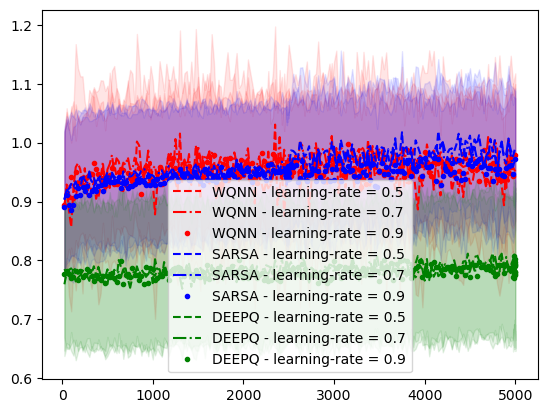

In [ ]:
criterion, val = 'learning-rate', 0.5

color = {"WQNN":'red',"SARSA":'blue',"DEEPQ":'green'}
    
for model in ["WQNN","SARSA","DEEPQ"]:#"ACTOR_CRITIC"
    for val, line in zip([0.5, 0.7, 0.9], ['--', '-.','.']):
        df = make_df(data, model, criterion, val)
        plt.fill_between(df.checkpoint, df['mean'] + df['std'], df['mean'] - df['std'], color=color[model], alpha=0.1)
        plt.plot(df.checkpoint, df['mean'],line, label =f'{model} - {criterion} = {val}', color=color[model])


plt.legend()

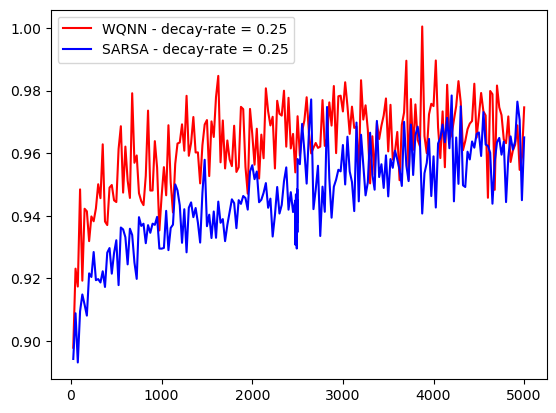

In [ ]:
criterion, val = 'decay-rate', 0.5

color = {"WQNN":'red',"SARSA":'blue',"DEEPQ":'green'}
    
for model in ["WQNN","SARSA"]:#"ACTOR_CRITIC"
    for val, line in zip([0.25], ['-', '.']):
        df = make_df(data, model, criterion, val)
        # plt.fill_between(df.checkpoint, df['mean'] + df['std'], df['mean'] - df['std'], color=color[model], alpha=0.1)
        plt.plot(df.checkpoint, df['mean'],line, label =f'{model} - {criterion} = {val}', color=color[model])

# plt.ylim([0.9,1.02])
plt.legend()

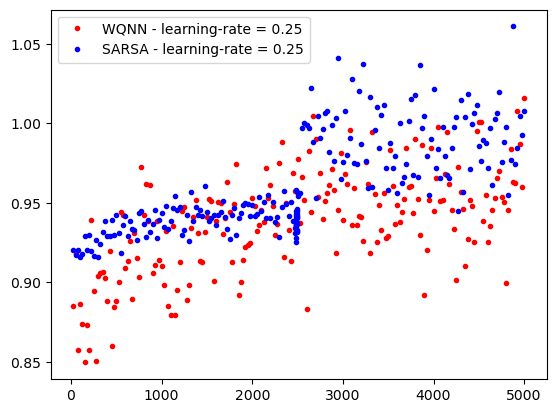

In [28]:
criterion, val = 'learning-rate', 0.5

color = {"WQNN":'red',"SARSA":'blue',"DEEPQ":'green'}
    
for model in ["WQNN","SARSA"]:#"ACTOR_CRITIC"
    for val, line in zip([0.25], ['.', '.']):
        df = make_df(data, model, criterion, val)
        # plt.fill_between(df.checkpoint, df['mean'] + df['std'], df['mean'] - df['std'], color=color[model], alpha=0.1)
        plt.plot(df.checkpoint, df['mean'],line, label =f'{model} - {criterion} = {val}', color=color[model])

# plt.ylim([0.9,1.02])
plt.legend()

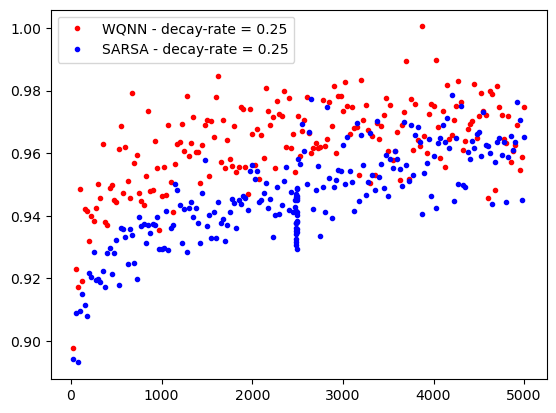

In [ ]:
criterion, val = 'decay-rate', 0.7

color = {"WQNN":'red',"SARSA":'blue',"DEEPQ":'green'}
    
for model in ["WQNN","SARSA"]:#"ACTOR_CRITIC"
    for val, line in zip([0.25], ['.', '.']):
        df = make_df(data, model, criterion, val)
        # plt.fill_between(df.checkpoint, df['mean'] + df['std'], df['mean'] - df['std'], color=color[model], alpha=0.1)
        plt.plot(df.checkpoint, df['mean'],line, label =f'{model} - {criterion} = {val}', color=color[model])

# plt.ylim([0.9,1.02])
plt.legend()

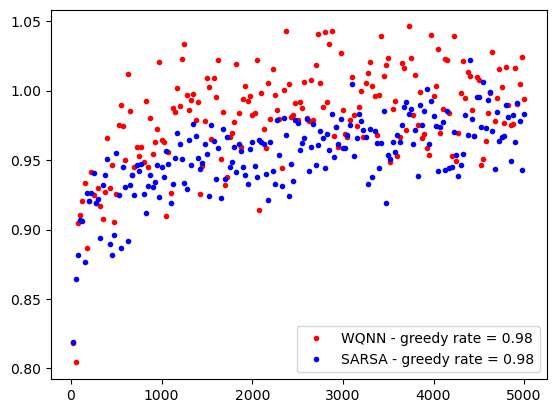

In [ ]:
criterion, val = 'epsilon', 0.5

color = {"WQNN":'red',"SARSA":'blue',"DEEPQ":'green'}
    
for model in ["WQNN","SARSA"]:#"ACTOR_CRITIC"
    for val, line in zip([0.98], ['.', '.']):
        df = make_df(data, model, criterion, val)
        # plt.fill_between(df.checkpoint, df['mean'] + df['std'], df['mean'] - df['std'], color=color[model], alpha=0.1)
        plt.plot(df.checkpoint, df['mean'],line, label =f'{model} - greedy rate = {val}', color=color[model])

# plt.ylim([0.9,1.02])
plt.legend()

In [22]:
criterion, val = 'learning-rate', 0.5

color = {"WQNN":'red',"SARSA":'blue',"REINFORCE":'green', "ACTOR_CRITIC":"yellow"}
    
for model in ["REINFORCE","ACTOR_CRITIC"]:#"ACTOR_CRITIC"
    for val, line in zip([0.98], ['.', '.']):
        df = make_df(data, model, criterion, val)
        # plt.fill_between(df.checkpoint, df['mean'] + df['std'], df['mean'] - df['std'], color=color[model], alpha=0.1)
        plt.plot(df.checkpoint, df['mean'],line, label =f'{model} - greedy rate = {val}', color=color[model])

# plt.ylim([0.9,1.02])
plt.legend()

NameError: name 'make_df' is not defined

In [ ]:
(data)

{"{'model': 'ACTOR_CRITIC', 'learning-rate': 0.25, 'decay-rate': 0.25, 'n-steps': 4.0, 'tuple-size': 160.0}": {'POA': {'100': [1683.1565710439677],
   '1000': [19853.666123063176],
   '1025': [7826.021047107359],
   '1050': [21542.74696686974],
   '1075': [13961.732594558282],
   '1100': [29273.88846195346],
   '1125': [21608.68151395304],
   '1150': [7926.312090537397],
   '1175': [14163.12434563099],
   '1200': [20661.9143804026],
   '1225': [19130.62670815183],
   '125': [13714.536826204945],
   '1250': [18233.76463822917],
   '1275': [13439.51196148881],
   '1300': [18673.698212883555],
   '1325': [18489.672571464198],
   '1350': [5666.812958730969],
   '1375': [20284.47478365998],
   '1400': [23976.57251841246],
   '1425': [15666.2546033731],
   '1450': [23749.752741051063],
   '1475': [13687.937326941717],
   '150': [3262.251349681317],
   '1500': [14106.990015802934],
   '1525': [21574.779779898912],
   '1550': [13012.855454186007],
   '1575': [17915.236771106334],
   '1600': [2

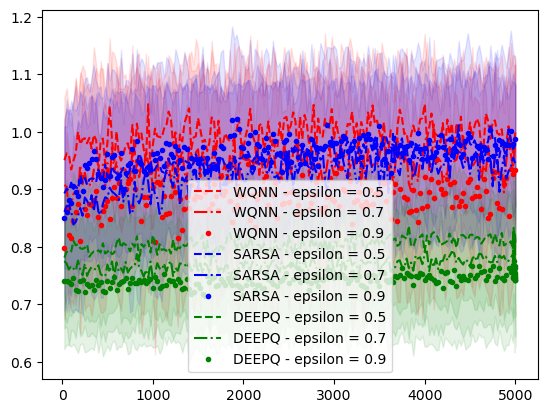

In [ ]:
criterion, val = 'epsilon', 0.5

color = {"WQNN":'red',"SARSA":'blue',"DEEPQ":'green'}
    
for model in ["WQNN","SARSA","DEEPQ"]:#"ACTOR_CRITIC"
    for val, line in zip([0.5, 0.7, 0.9], ['--', '-.','.']):
        df = make_df(data, model, criterion, val)
        plt.fill_between(df.checkpoint, df['mean'] + df['std'], df['mean'] - df['std'], color=color[model], alpha=0.1)
        plt.plot(df.checkpoint, df['mean'],line, label =f'{model} - {criterion} = {val}', color=color[model])


plt.legend()

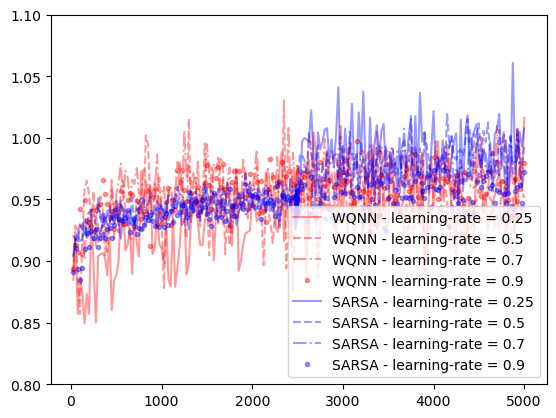

In [ ]:
criterion, val = 'learning-rate', 0.5

color = {"WQNN":'red',"SARSA":'blue'}
    
for model in ["WQNN","SARSA"]:#"ACTOR_CRITIC"
    for val, line in zip([0.25, 0.5, 0.7, 0.9], ["-", '--', '-.','.']):
        df = make_df(data, model, criterion, val)
        # plt.fill_between(df.checkpoint, df['mean'] + df['std'], df['mean'] - df['std'], color=color[model], alpha=0.1)
        plt.plot(df.checkpoint, df['mean'],line, label =f'{model} - {criterion} = {val}', color=color[model], alpha=0.4)

plt.ylim([0.8,1.1])
plt.legend()

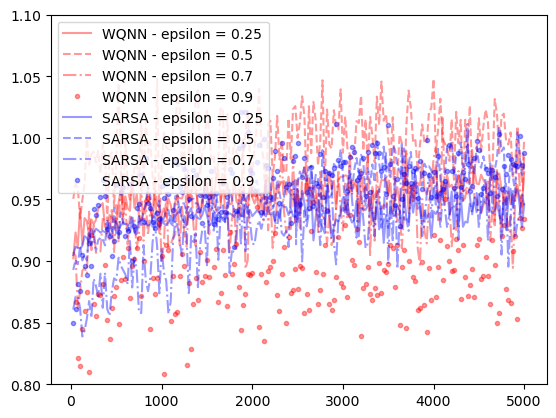

In [ ]:
criterion, val = 'epsilon', 0.5

color = {"WQNN":'red',"SARSA":'blue'}
    
for model in ["WQNN","SARSA"]:#"ACTOR_CRITIC"
    for val, line in zip([0.25, 0.5, 0.7, 0.9], ["-", '--', '-.','.']):
        df = make_df(data, model, criterion, val)
        # plt.fill_between(df.checkpoint, df['mean'] + df['std'], df['mean'] - df['std'], color=color[model], alpha=0.1)
        plt.plot(df.checkpoint, df['mean'],line, label =f'{model} - {criterion} = {val}', color=color[model], alpha=0.4)

plt.ylim([0.8,1.1])
plt.legend()

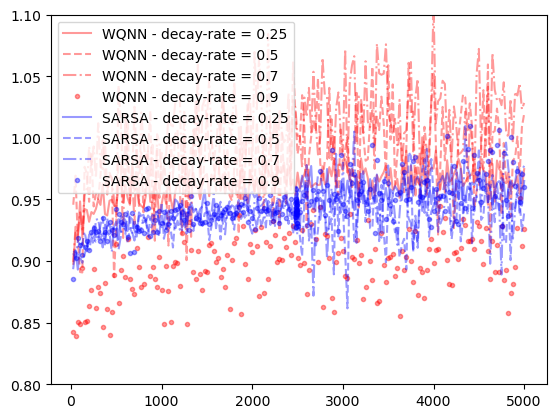

In [ ]:
criterion, val = 'decay-rate', 0.5

color = {"WQNN":'red',"SARSA":'blue'}
    
for model in ["WQNN","SARSA"]:#"ACTOR_CRITIC"
    for val, line in zip([0.25, 0.5, 0.7, 0.9], ["-", '--', '-.','.']):
        df = make_df(data, model, criterion, val)
        # plt.fill_between(df.checkpoint, df['mean'] + df['std'], df['mean'] - df['std'], color=color[model], alpha=0.1)
        plt.plot(df.checkpoint, df['mean'],line, label =f'{model} - {criterion} = {val}', color=color[model], alpha=0.4)

plt.ylim([0.8,1.1])
plt.legend()

KeyError: 'checkpoint'

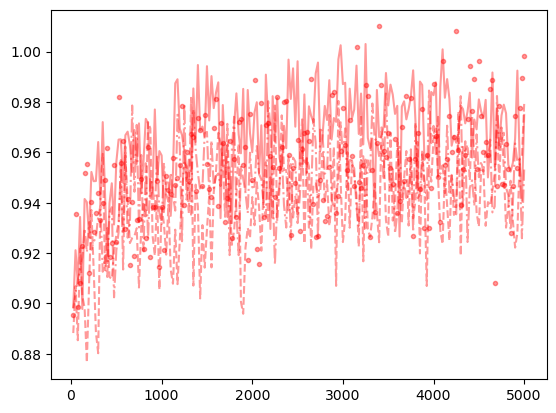

In [ ]:
criterion, val = 'forget-factor', 0.5

color = {"WQNN":'red',"SARSA":'blue'}
    
for model in ["WQNN","SARSA"]:#"ACTOR_CRITIC"
    for val, line in zip([0.25, 0.5, 0.7, 0.9], ["-", '--', '-.','.']):
        df = make_df(data, model, criterion, val)
        # plt.fill_between(df.checkpoint, df['mean'] + df['std'], df['mean'] - df['std'], color=color[model], alpha=0.1)
        plt.plot(df.checkpoint, df['mean'],line, label =f'{model} - {criterion} = {val}', color=color[model], alpha=0.4)

plt.ylim([0.8,1.1])
plt.legend()

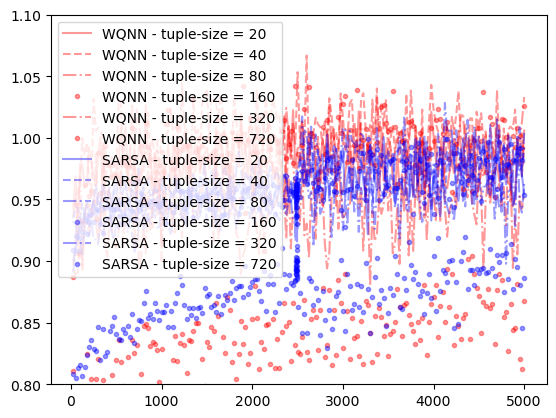

In [ ]:
criterion, val = 'tuple-size', 0.5

color = {"WQNN":'red',"SARSA":'blue'}
    
for model in ["WQNN","SARSA"]:#"ACTOR_CRITIC"
    for val, line in zip([20, 40, 80, 160, 320, 720], ["-", '--', '-.','.', '-.','.']):
        df = make_df(data, model, criterion, val)
        # plt.fill_between(df.checkpoint, df['mean'] + df['std'], df['mean'] - df['std'], color=color[model], alpha=0.1)
        plt.plot(df.checkpoint, df['mean'],line, label =f'{model} - {criterion} = {val}', color=color[model], alpha=0.4)

plt.ylim([0.8,1.1])
plt.legend()

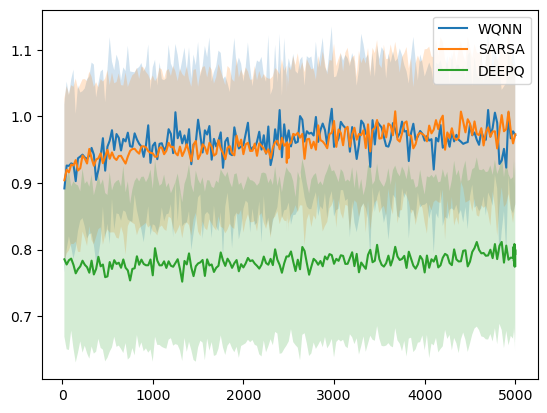

In [ ]:
for model in ["WQNN","SARSA","DEEPQ"]:#"ACTOR_CRITIC"
    df = make_df(data[model]['transp'])
    
    plt.fill_between(df.checkpoint, df['mean'] + df['std'], df['mean'] - df['std'], alpha=0.2)
    plt.plot(df.checkpoint, df['mean'], label = model)


plt.legend()

In [ ]:
def make_df(x):
    raw = [{'checkpoint':int(i) , 'mean': np.mean(x[i]) , 'std': np.std(x[i]) } for i in x]
    return pd.DataFrame(raw).sort_values('checkpoint')

df = make_df(data[params['model']]['reward'])

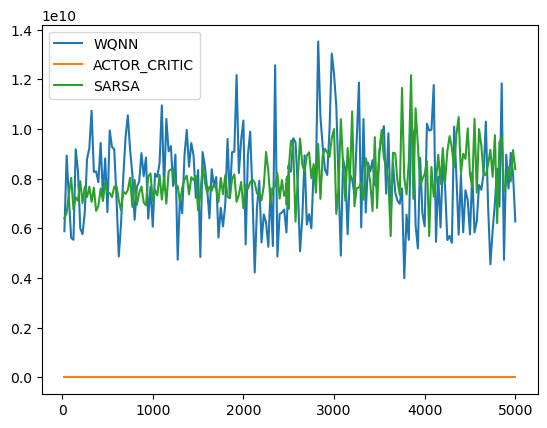

{'100': [6300905147.602312,
  5274561454.844473,
  1322212211.4157214,
  6908964323.50536,
  6214816212.535497,
  6061187439.978111,
  21664891722.903915,
  4198365172.717674,
  13676508330.075851,
  2025570200.7874675,
  1409382152.5846894,
  -106172947.13423684,
  1855973115.9436402,
  7574217007.711902,
  -89825941.10676637],
 '125': [918589699.3262619,
  5414464352.7976055,
  565969175.5762646,
  12525863569.062727,
  2649535392.4250364,
  1770696369.9622512,
  17746568626.26028,
  1228484761.021383,
  8068806612.02412,
  2398318365.778962,
  2752728615.4346423,
  8547732393.044745,
  5010196782.43688,
  1113505263.749461,
  12445696088.246235],
 '150': [17219837039.863014,
  522748771.0853715,
  13121140097.990295,
  14242313531.608326,
  4828603807.389675,
  5584064857.31281,
  30289822579.92875,
  7362375905.75425,
  9448533606.84243,
  3371337620.982379,
  2515188257.79628,
  13893277298.798916,
  5910744966.231014,
  4705591282.48508,
  4772302635.172531],
 '175': [49059931.59

In [ ]:
results = {}
model = 'SARSA'

dfr = []
examples_cs = {}
examples_br = {}

for folder in dict_params:
    print(folder)
    example_cs = pd.DataFrame()
    example_br = pd.DataFrame()
    ghi = 0
    ratio = 0

    sghi = 0
    sref = 0#,[]
    smodel = 0#,[]
    c=0
    for df in dataframes[folder]:
        if df.ghi.sum() > ghi:
            example_cs = df.copy()
            ghi = df.ghi.sum()

        if df.POA.sum()/df.mg.sum() > ratio:
            example_br = df.copy()
            ratio = df.POA.sum()/df.mg.sum() 

        sghi += df.ghi.sum()
        sref += df.mg.sum()# [df.mg.sum()/df.ghi.sum()]
        smodel += df.POA.sum()# [df.POA.sum()/df.ghi.sum()]
        c+=1

    examples_cs[folder] = example_cs
    examples_br[folder] = example_br
        
    r =  dict_params[folder]


    r['model_transp'] = smodel/sghi# np.median(smodel)
    r['ref_transp'] = sref/sghi# np.median(sref)
    r['days'] = c


    dfr.append(r)

./results/v02\ACTOR_CRITIC\evaluation\learning-rate=0.25_decay-rate=0.25_n-steps=4_tuple-size=160
./results/v02\ACTOR_CRITIC\evaluation\learning-rate=0.5_decay-rate=0.5_n-steps=1_tuple-size=160
./results/v02\ACTOR_CRITIC\evaluation\learning-rate=0.5_decay-rate=0.5_n-steps=2_tuple-size=160
./results/v02\ACTOR_CRITIC\evaluation\learning-rate=0.5_decay-rate=0.5_n-steps=4_tuple-size=160
./results/v02\ACTOR_CRITIC\evaluation\learning-rate=0.5_decay-rate=0.7_n-steps=8_tuple-size=20
./results/v02\ACTOR_CRITIC\evaluation\learning-rate=0.7_decay-rate=0.5_n-steps=16_tuple-size=160
./results/v02\ACTOR_CRITIC\evaluation\learning-rate=0.7_decay-rate=0.5_n-steps=1_tuple-size=160
./results/v02\ACTOR_CRITIC\evaluation\learning-rate=0.7_decay-rate=0.5_n-steps=2_tuple-size=160
./results/v02\ACTOR_CRITIC\evaluation\learning-rate=0.7_decay-rate=0.5_n-steps=4_tuple-size=160
./results/v02\ACTOR_CRITIC\evaluation\learning-rate=0.7_decay-rate=0.5_n-steps=8_tuple-size=160
./results/v02\ACTOR_CRITIC\evaluation\

In [ ]:
dffinal = pd.DataFrame.from_records(dfr).assign(ratio = lambda dfx: dfx.model_transp/dfx.ref_transp)
dffinal.query('days > 1').sort_values('ratio', ascending=False).head(10)

,model,learning-rate,decay-rate,n-steps,tuple-size,model_transp,ref_transp,days,epsilon,forget-factor,ratio
456,WQNN,0.90,0.25,NaN,160.0,1.099492,1.107895,25,0.98,0.25,0.992415
286,SARSA,0.25,0.25,4.0,160.0,1.091863,1.107895,25,0.90,NaN,0.985529
291,SARSA,0.70,0.50,4.0,40.0,1.087566,1.107895,25,0.90,NaN,0.981651
450,WQNN,0.70,0.25,NaN,40.0,1.086130,1.107895,25,0.98,0.98,0.980355
250,SARSA,0.25,0.25,4.0,80.0,1.085867,1.107895,25,0.98,NaN,0.980118
429,WQNN,0.25,0.25,NaN,40.0,1.084552,1.107895,25,0.70,0.25,0.978931
268,SARSA,0.70,0.90,4.0,80.0,1.081555,1.107895,25,0.98,NaN,0.976226
287,SARSA,0.25,0.50,2.0,80.0,1.081068,1.107895,25,0.90,NaN,0.975785
457,WQNN,0.90,0.70,NaN,160.0,1.080478,1.107895,25,0.98,0.25,0.975253
285,SARSA,0.25,0.25,1.0,80.0,1.080442,1.107895,25,0.90,NaN,0.975221


In [ ]:
dffinal.query('days > 1').groupby('model').count()[['days']]

,days
model,
ACTOR_CRITIC,5
REINFORCE,21
SARSA,274
WQNN,160


In [ ]:
dffinal.query('days > 1').groupby('model').max()[['ratio']]

,ratio
model,
ACTOR_CRITIC,0.918784
REINFORCE,0.906748
SARSA,0.985529
WQNN,0.992415


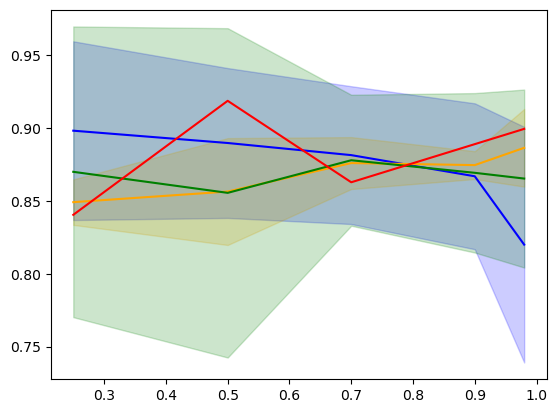

In [ ]:
m = "SARSA"
y = dffinal.query(f'days > 1 and model == "{m}"').groupby('learning-rate')[['ratio']].std()
x = dffinal.query(f'days > 1 and model == "{m}"').groupby('learning-rate')[['ratio']].mean()

plt.fill_between(y.index, (x['ratio'] + y['ratio']), (x['ratio'] - y['ratio']), alpha=0.2, color='blue')
plt.plot(x.index, x[['ratio']], color='blue')

m = "REINFORCE"
y = dffinal.query(f'days > 1 and model == "{m}"').groupby('learning-rate')[['ratio']].std()
x = dffinal.query(f'days > 1 and model == "{m}"').groupby('learning-rate')[['ratio']].mean()

plt.fill_between(y.index, (x['ratio'] + y['ratio']), (x['ratio'] - y['ratio']), alpha=0.2, color='orange')
plt.plot(x.index, x[['ratio']], color='orange')

m = "WQNN"
y = dffinal.query(f'days > 1 and model == "{m}"').groupby('learning-rate')[['ratio']].std()
x = dffinal.query(f'days > 1 and model == "{m}"').groupby('learning-rate')[['ratio']].mean()

plt.fill_between(y.index, (x['ratio'] + y['ratio']), (x['ratio'] - y['ratio']), alpha=0.2, color='green')
plt.plot(x.index, x[['ratio']], color='green')

m = "ACTOR_CRITIC"
y = dffinal.query(f'days > 1 and model == "{m}"').groupby('learning-rate')[['ratio']].std()
x = dffinal.query(f'days > 1 and model == "{m}"').groupby('learning-rate')[['ratio']].mean()

plt.fill_between(y.index, (x['ratio'] + y['ratio']), (x['ratio'] - y['ratio']), alpha=0.2, color='red')
plt.plot(x.index, x[['ratio']], color='red')


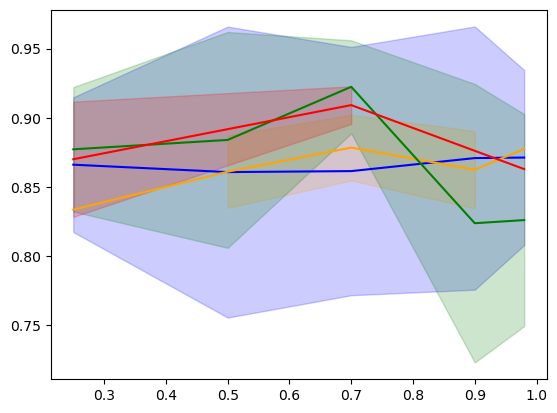

: 

In [ ]:
param = 'decay-rate'

m = "SARSA"
y = dffinal.query(f'days > 1 and model == "{m}"').groupby(param)[['ratio']].std()
x = dffinal.query(f'days > 1 and model == "{m}"').groupby(param)[['ratio']].mean()

plt.fill_between(y.index, (x['ratio'] + y['ratio']), (x['ratio'] - y['ratio']), alpha=0.2, color='blue')
plt.plot(x.index, x[['ratio']], color='blue')

m = "REINFORCE"
y = dffinal.query(f'days > 1 and model == "{m}"').groupby(param)[['ratio']].std()
x = dffinal.query(f'days > 1 and model == "{m}"').groupby(param)[['ratio']].mean()

plt.fill_between(y.index, (x['ratio'] + y['ratio']), (x['ratio'] - y['ratio']), alpha=0.2, color='orange')
plt.plot(x.index, x[['ratio']], color='orange')

m = "WQNN"
y = dffinal.query(f'days > 1 and model == "{m}"').groupby(param)[['ratio']].std()
x = dffinal.query(f'days > 1 and model == "{m}"').groupby(param)[['ratio']].mean()

plt.fill_between(y.index, (x['ratio'] + y['ratio']), (x['ratio'] - y['ratio']), alpha=0.2, color='green')
plt.plot(x.index, x[['ratio']], color='green')

m = "ACTOR_CRITIC"
y = dffinal.query(f'days > 1 and model == "{m}"').groupby(param)[['ratio']].std()
x = dffinal.query(f'days > 1 and model == "{m}"').groupby(param)[['ratio']].mean()

plt.fill_between(y.index, (x['ratio'] + y['ratio']), (x['ratio'] - y['ratio']), alpha=0.2, color='red')
plt.plot(x.index, x[['ratio']], color='red')


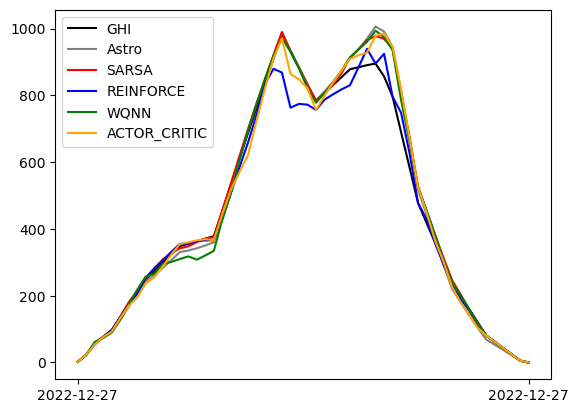

In [ ]:
n = 25
a = dffinal.query('days > 1 and model == "SARSA"').sort_values('ratio', ascending=False).reset_index().iloc[0]
df = pd.read_csv(f'results/v02/SARSA/evaluation/epsilon={a["epsilon"]}_learning-rate={a["learning-rate"]}_decay-rate={a["decay-rate"]}_n_steps={int(a["n-steps"])}_tuple-size={int(a["tuple-size"])}/checkpoint_{n}.csv', parse_dates=['ts'], index_col='ts')
df = df.query('mg > 0')
plt.plot(df.index, df.ghi, label = 'GHI', c='black')
plt.plot(df.index, df.mg, label = 'Astro', c='grey')
plt.plot(df.index, df.POA, label = 'SARSA', c='red')

a = dffinal.query('days > 1 and model == "REINFORCE"').sort_values('ratio', ascending=False).reset_index().iloc[0]
df = pd.read_csv(f'results/v02/REINFORCE/evaluation/learning-rate={a["learning-rate"]}_decay-rate={a["decay-rate"]}_tuple-size={int(a["tuple-size"])}/checkpoint_{n}.csv', parse_dates=['ts'], index_col='ts')
df = df.query('mg > 0')
plt.plot(df.index, df.POA, label = 'REINFORCE', c='blue')

a = dffinal.query('days > 1 and model == "WQNN"').sort_values('ratio', ascending=False).reset_index().iloc[0]
df = pd.read_csv(f'results/v02/WQNN/evaluation/epsilon={a["epsilon"]}_learning-rate={a["learning-rate"]}_decay-rate={a["decay-rate"]}_forget-factor={a["forget-factor"]}_tuple-size={int(a["tuple-size"])}/checkpoint_{n}.csv', parse_dates=['ts'], index_col='ts')
df = df.query('mg > 0')
plt.plot(df.index, df.POA, label = 'WQNN', c='green')

m = "ACTOR_CRITIC"
a = dffinal.query(f'days > 1 and model == "{m}"').sort_values('ratio', ascending=False).reset_index().iloc[0]
df = pd.read_csv(f'results/v02/{m}/evaluation/learning-rate={a["learning-rate"]}_decay-rate={a["decay-rate"]}_n-steps={int(a["n-steps"])}_tuple-size={int(a["tuple-size"])}/checkpoint_{n}.csv', parse_dates=['ts'], index_col='ts')
df = df.query('mg > 0')
plt.plot(df.index, df.POA, label = m, c='orange')

plt.xticks([df.index.min(), df.index.max()])
plt.legend()

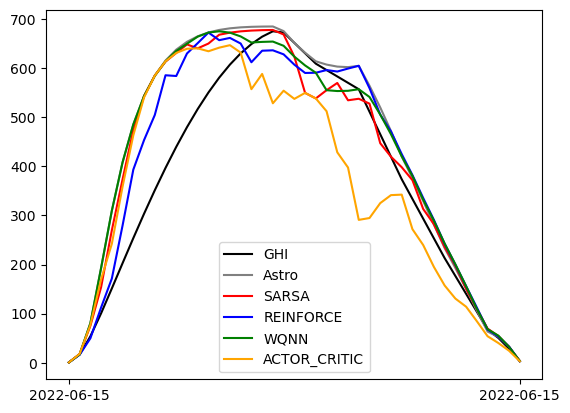

In [ ]:
n=12
a = dffinal.query('days > 1 and model == "SARSA"').sort_values('ratio', ascending=False).reset_index().iloc[0]
df = pd.read_csv(f'results/v02/SARSA/evaluation/epsilon={a["epsilon"]}_learning-rate={a["learning-rate"]}_decay-rate={a["decay-rate"]}_n_steps={int(a["n-steps"])}_tuple-size={int(a["tuple-size"])}/checkpoint_{n}.csv', parse_dates=['ts'], index_col='ts')
df = df.query('mg > 0')
plt.plot(df.index, df.ghi, label = 'GHI', c='black')
plt.plot(df.index, df.mg, label = 'Astro', c='grey')
plt.plot(df.index, df.POA, label = 'SARSA', c='red')

a = dffinal.query('days > 1 and model == "REINFORCE"').sort_values('ratio', ascending=False).reset_index().iloc[0]
df = pd.read_csv(f'results/v02/REINFORCE/evaluation/learning-rate={a["learning-rate"]}_decay-rate={a["decay-rate"]}_tuple-size={int(a["tuple-size"])}/checkpoint_{n}.csv', parse_dates=['ts'], index_col='ts')
df = df.query('mg > 0')
plt.plot(df.index, df.POA, label = 'REINFORCE', c='blue')

a = dffinal.query('days > 1 and model == "WQNN"').sort_values('ratio', ascending=False).reset_index().iloc[0]
df = pd.read_csv(f'results/v02/WQNN/evaluation/epsilon={a["epsilon"]}_learning-rate={a["learning-rate"]}_decay-rate={a["decay-rate"]}_forget-factor={a["forget-factor"]}_tuple-size={int(a["tuple-size"])}/checkpoint_{n}.csv', parse_dates=['ts'], index_col='ts')
df = df.query('mg > 0')
plt.plot(df.index, df.POA, label = 'WQNN', c='green')

m = "ACTOR_CRITIC"
a = dffinal.query(f'days > 1 and model == "{m}"').sort_values('ratio', ascending=False).reset_index().iloc[0]
df = pd.read_csv(f'results/v02/{m}/evaluation/learning-rate={a["learning-rate"]}_decay-rate={a["decay-rate"]}_n-steps={int(a["n-steps"])}_tuple-size={int(a["tuple-size"])}/checkpoint_{n}.csv', parse_dates=['ts'], index_col='ts')
df = df.query('mg > 0')
plt.plot(df.index, df.POA, label = m, c='orange')

plt.xticks([df.index.min(), df.index.max()])
plt.legend()

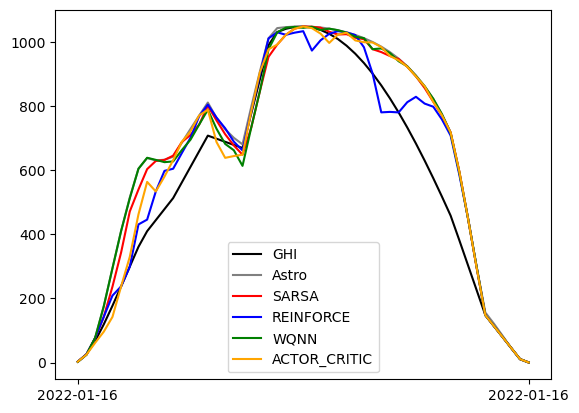

In [ ]:
n=2
a = dffinal.query('days > 1 and model == "SARSA"').sort_values('ratio', ascending=False).reset_index().iloc[0]
df = pd.read_csv(f'results/v02/SARSA/evaluation/epsilon={a["epsilon"]}_learning-rate={a["learning-rate"]}_decay-rate={a["decay-rate"]}_n_steps={int(a["n-steps"])}_tuple-size={int(a["tuple-size"])}/checkpoint_{n}.csv', parse_dates=['ts'], index_col='ts')
df = df.query('mg > 0')
plt.plot(df.index, df.ghi, label = 'GHI', c='black')
plt.plot(df.index, df.mg, label = 'Astro', c='grey')
plt.plot(df.index, df.POA, label = 'SARSA', c='red')

a = dffinal.query('days > 1 and model == "REINFORCE"').sort_values('ratio', ascending=False).reset_index().iloc[0]
df = pd.read_csv(f'results/v02/REINFORCE/evaluation/learning-rate={a["learning-rate"]}_decay-rate={a["decay-rate"]}_tuple-size={int(a["tuple-size"])}/checkpoint_{n}.csv', parse_dates=['ts'], index_col='ts')
df = df.query('mg > 0')
plt.plot(df.index, df.POA, label = 'REINFORCE', c='blue')


a = dffinal.query('days > 1 and model == "WQNN"').sort_values('ratio', ascending=False).reset_index().iloc[0]
df = pd.read_csv(f'results/v02/WQNN/evaluation/epsilon={a["epsilon"]}_learning-rate={a["learning-rate"]}_decay-rate={a["decay-rate"]}_forget-factor={a["forget-factor"]}_tuple-size={int(a["tuple-size"])}/checkpoint_{n}.csv', parse_dates=['ts'], index_col='ts')
df = df.query('mg > 0')
plt.plot(df.index, df.POA, label = 'WQNN', c='green')

m = "ACTOR_CRITIC"
a = dffinal.query(f'days > 1 and model == "{m}"').sort_values('ratio', ascending=False).reset_index().iloc[0]
df = pd.read_csv(f'results/v02/{m}/evaluation/learning-rate={a["learning-rate"]}_decay-rate={a["decay-rate"]}_n-steps={int(a["n-steps"])}_tuple-size={int(a["tuple-size"])}/checkpoint_{n}.csv', parse_dates=['ts'], index_col='ts')
df = df.query('mg > 0')
plt.plot(df.index, df.POA, label = m, c='orange')

plt.xticks([df.index.min(), df.index.max()])
plt.legend()